In [1]:
#!/usr/bin/env python
# coding: utf-8

# # Creating an optimisation with meta parameters
# 
# This notebook will explain how to set up an optimisation that uses metaparameters (parameters that control other parameters)


import bluepyopt as bpop
import bluepyopt.ephys as ephys
import pickle
from sciunit.scores import ZScore
from sciunit import TestSuite
from sciunit.scores.collections import ScoreArray
import sciunit
import numpy as np
from neuronunit.optimisation.optimization_management import dtc_to_rheo, switch_logic,active_values
from neuronunit.tests.base import AMPL, DELAY, DURATION

import quantities as pq
PASSIVE_DURATION = 500.0*pq.ms
PASSIVE_DELAY = 200.0*pq.ms
import matplotlib.pyplot as plt
from bluepyopt.ephys.models import ReducedCellModel
import numpy
from neuronunit.optimisation.optimization_management import test_all_objective_test
from neuronunit.optimisation.optimization_management import check_binary_match, three_step_protocol,inject_and_plot_passive_model
from neuronunit.optimisation.model_parameters import MODEL_PARAMS
import copy
MODEL_PARAMS["IZHI"].pop('C',None)
MODEL_PARAMS["IZHI"].pop('k',None)
MODEL_PARAMS["IZHI"].pop('vr',None)
MODEL_PARAMS["IZHI"].pop('vPeak',None)

'''

MODEL_PARAMS["IZHI"].pop('vt',None)
#MODEL_PARAMS["IZHI"].pop('a',None)
MODEL_PARAMS["IZHI"].pop('d',None)
#MODEL_PARAMS["IZHI"].pop('c',None)
'''
#MODEL_PARAMS["IZHI"].pop('C',None)
#MODEL_PARAMS["IZHI"].pop('k',None)

import numpy as np


simple_cell = ephys.models.ReducedCellModel(
        name='simple_cell',
        params=MODEL_PARAMS["IZHI"],backend="IZHI")  
simple_cell.backend = "IZHI"


# First we need to import the module that contains all the functionality to create electrical cell models

# If you want to see a lot of information about the internals, 
# the verbose level can be set to 'debug' by commenting out
# the following lines

# Setting up the cell
# ---------------------
# This is very similar to the simplecell example in the directory above. For a more detailed explanation, look there.

# For this example we will create two separate parameters to store the specific capacitance. One for the soma and one for the soma. We will put a metaparameter on top of these two to keep the value between soma and axon the same.

# The metaparameter, the one that will be optimised, will make sure the two parameters above keep always the same value

# And parameters that represent the maximal conductance of the sodium and potassium channels. These two parameters will be not be optimised but are frozen.

# ### Creating the template
# 
# To create the cell template, we pass all these objects to the constructor of the template.
# We *only* put the metaparameter, not its subparameters.


simple_cell = ephys.models.ReducedCellModel(
        name='simple_cell',
        params=MODEL_PARAMS["IZHI"],backend="IZHI")  
simple_cell.backend = "IZHI"


# Now we can print out a description of the cell

model = simple_cell
model.params = {k:np.mean(v) for k,v in model.params.items() }
from make_allen_tests import AllenTest

from sciunit.scores import ZScore
tests = pickle.load(open("processed_multicellular_constraints.p","rb"))
nu_tests = tests['Hippocampus CA1 pyramidal cell'].tests
nu_tests[0].score_type = ZScore

simulated_experiment = True
features = None
allen = True
from collections.abc import Iterable

if simulated_experiment:
    while features is None:
        aug_nu_tests, OM, target = test_all_objective_test(MODEL_PARAMS["IZHI"],model_type="IZHI",protocol={'allen':False,'elephant':True})
        target = three_step_protocol(target)
        if hasattr(target,'everything'):
            features = copy.copy(target.everything)
            
            check_list = {key:feat for key,feat in features.items() if not feat is None and type(feat) is not type(Iterable) and feat !=0 and feat !=1 }
            check_list.pop('depol_block_1.5x',None)
            check_list.pop('is_not_stuck_3.0x',None)
            check_list.pop('is_not_stuck_1.5x',None)
            scale = 2.0/len(check_list)
            if scale > 0.009999:
                print('not high enough definition')
                features = None
                continue
            
            if allen:
                simple_cell.allen = None
                simple_cell.allen = True

                tests = pickle.load(open("allen_NU_tests.p","rb"))
                print('allen cell',tests[0].name)
                nu_tests = tests[0]
                for t in nu_tests:
                    to_pop = []
                    if t.name in features.keys():
                        if features[t.name] is not None:
                            t.set_observation(features[t.name])
                            if t.observation['mean'] is not None:
                                t.observation['std'] = np.abs(np.mean(t.observation['mean']))
                        to_pop.append(t.name)
                        
                    [ features.pop(i,None) for i in to_pop ]
                '''
                more_tests = []
                for feat in features:    
                    if feat is not None:
                        at = AllenTest(name=feat)
                        at.set_observation(features[at.name])
                        if at.observation['mean'] is not None:
                            at.observation['std'] = np.abs(np.mean(t.observation['mean']))
                            more_tests.append(at)
                features = copy.copy(target.everything)
                nu_tests = [t for t in nu_tests.tests]
                nu_tests.extend(more_tests)
                
                '''
                    

/home/user/anaconda3/lib/python3.7/site-packages/airspeed/__init__.py:505: FutureWarning: Possible nested set at position 8
  KEYVALSEP = re.compile(r'[ \t]*:[[ \t]*(.*)$', re.S)


Random simulated data tests made
{'value': array(207.64160156) * pA}
{'value': array(2.48522257) * ms}
{'mean': array(-65.22618636) * mV, 'std': array(1.42108547e-14) * mV}
{'value': array(27142125.68227196) * kg*m**2/(s**3*A**2)}
{'value': array(9.15632989e-11) * s**4*A**2/(kg*m**2)}
{'mean': array(0.00037) * s, 'std': array(0.) * s, 'n': 1}
{'value': array(48.59496913) * mV, 'mean': array(48.59496913) * mV, 'std': array(0.) * mV, 'n': 1}
{'mean': array(-27.45663019) * mV, 'std': array(0.) * mV, 'n': 1}
allen cell 504615116


In [2]:
features = target.everything


for key,feat in features.items():
    if isinstance(feat, int):
        print(key,feat)
features
nu_tests;

In [3]:

big_list = []
for tt in aug_nu_tests.values():
    tt.core = None
    tt.core = True
    big_list.append(tt)
big_list.extend(nu_tests)
nu_tests = big_list


In [4]:
#big_list = []
#for tt in nu_tests:
#    big_list.append(tt)
#big_list.extend(more_tests)
#nu_tests = big_list
#    feature_name = '%s' % (tt.name)
#    print(feature_name)
import efel
import pandas as pd
import seaborn as sns
list(efel.getFeatureNames());

def basic_expVar(trace1, trace2):
    # https://github.com/AllenInstitute/GLIF_Teeter_et_al_2018/blob/master/query_biophys/query_biophys_expVar.py
    '''This is the fundamental calculation that is used in all different types of explained variation.  
    At a basic level, the explained variance is calculated between two traces.  These traces can be PSTH's
    or single spike trains that have been convolved with a kernel (in this case always a Gaussian)
    Input:
        trace 1 & 2:  1D numpy array containing values of the trace.  (This function requires numpy array
                        to ensure that this is not a multidemensional list.)
    Returns:
        expVar:  float value of explained variance
    '''
    
    var_trace1=np.var(trace1)
    var_trace2=np.var(trace2)
    var_trace1_minus_trace2=np.var(trace1-trace2)

    if var_trace1_minus_trace2 == 0.0:
        return 1.0
    else:
        return (var_trace1+var_trace2-var_trace1_minus_trace2)/(var_trace1+var_trace2)

In [5]:
 
class NUFeatureAllen(object):
    def __init__(self,test,model,cnt,target,check_list,spike_obs,print_stuff=False):
        self.test = test
        self.model = model
        self.check_list = check_list
        self.spike_obs = spike_obs
        self.cnt = cnt
        self.target = target
        self.print_stuff = print_stuff
    def calculate_score(self,responses):
        if not 'features' in responses.keys():# or not 'model' in responses.keys():
            return 100.0
        check_list = self.check_list

    
        features = responses['features']

        
        feature_name = self.test.name
        if feature_name not in features.keys():
            return 100.0
        
        if features[feature_name] is None:
            return 100.0
            
        if type(features[self.test.name]) is type(Iterable):
            features[self.test.name] = np.mean(features[self.test.name])
        self.test.observation['std'] = np.abs(np.mean(self.test.observation['mean']))
        self.test.observation['mean'] = np.mean(self.test.observation['mean'])            
        self.test.set_prediction(np.mean(features[self.test.name]))
        
        if 'Spikecount_3.0x'==feature_name or 'Spikecount_1.5x'==feature_name:
            delta = np.abs(features[self.test.name]-np.mean(self.test.observation['mean']))

            
            return delta
        else:
            delta0 = np.abs(features['Spikecount_3.0x']-np.mean(self.spike_obs[0]['mean']))
            delta1 = np.abs(features['Spikecount_1.5x']-np.mean(self.spike_obs[1]['mean']))
            #if self.print_stuff:
            #    print(features['Spikecount_3.0x'],np.mean(self.spike_obs[0]['mean']))
            #    print(features['Spikecount_1.5x'],np.mean(self.spike_obs[1]['mean']))


            #else:

            #if hasattr(self.test,'core'):
            #    score = self.calculate_score_core(responses)
            #    score = 0.000925*score
            #    return score 
            '''
            if self.cnt==287:# 286 spike_width2_3.0x
                delta0 = 0.03*(1.0-float(basic_expVar(responses['dtc'].vm15,self.target.vm15)))
                delta1 = 0.03*(1.0-float(basic_expVar(responses['dtc'].vm30,self.target.vm30)))
                return delta0+delta1
            if self.cnt==286:
                delta = 0.03*(1.0-basic_expVar(responses['dtc'].vmrh,self.target.vmrh))
                return float(delta)                
            print(self.cnt,feature_name)
            '''

            if feature_name in check_list:
                if features[feature_name] is None:
                    return 100.0
                score_gene = self.test.feature_judge()
                if score_gene is not None:
                    if score_gene.log_norm_score is not None:

                        delta = np.abs(float(score_gene.log_norm_score))
                        if delta==np.inf:
                            if score_gene.raw is not None:
                                delta =  np.abs(float(score_gene.raw))
                    else:
                        if score_gene.raw is not None:
                            delta =  np.abs(float(score_gene.raw))
                        else:
                            delta = np.abs(features[feature_name]-np.mean(self.test.observation['mean']))
                            
                else:
                    delta = np.abs(features[feature_name]-np.mean(self.test.observation['mean']))

                if np.isnan(delta):

                    delta = 100.0
                if delta is None:

                    delta = 100.0
                score = 0.000001*delta
               
          
                if 'AP_rise_rate_change_1.5x'==feature_name:
                    score = score/10.0

                if 'AP1_width_1.5'==feature_name:
                    score = score/100.0
                if 'AHP_depth_diff_1.5x'==feature_name:
                    score = score/100.0
                if 'AP2_AP1_begin_width_diff_1.5x'==feature_name:
                    score = score/1000000000.0
                if 'amp_drop_first_second_1.5x'==feature_name:
                    score = score/1000000000.0

                if 'AP_duration_half_width_change_3.0x'==feature_name:
                    score = score/1000000000.0

                if 'spike_width2_3.0x'==feature_name:
                    score = score/1000000000.0

                if 'AP_duration_half_width_change_3.0x'==feature_name:
                    score = score/1000000000.0

                if 'AP_duration_half_width_change_1.5x'==feature_name:
                    score = score/10000000000.0
                    

                if 'AP_duration_change_3.0x'==feature_name:
                    score = score/1000000000.0


                if 'AP_duration_half_width_change_3.0x'==feature_name:
                    score = score/1000000000.0
                    
                    
                if 'AP_duration_half_width_change_1.5x'==feature_name:
                    score = score/100.0
                if 'decay_time_constant_after_stim_1.5x'==feature_name:
                    score = score/100.0
                if 'AP_duration_half_width_change_1.5x'==feature_name:
                    score = score/100.0

                #if score>1.0:
                #    print(score,'hit',feature_name)
                #    score = score/100.0
                #    print(self.cnt)
                return score+(delta0+delta1)

        print(feature_name,'\n\n\n\n leaked case \n\n\n\n')

objectives = []
spike_obs = []#[None for i in range(0,1) ]
for tt in nu_tests:
    if 'Spikecount_3.0x' == tt.name:# or 'spike_width2_3.0x' in tt.name or 'AHP_time_from_peak_3.0x' in tt.name:# or 'isi' in tt.name or 'cv' in tt.name:
        spike_obs.append(tt.observation)
    if 'Spikecount_1.5x'== tt.name:
        spike_obs.append(tt.observation)
spike_obs = sorted(spike_obs, key=lambda k: k['mean'],reverse=True)

for cnt,tt in enumerate(nu_tests):
    feature_name = '%s' % (tt.name)
    if feature_name in check_list:
        if 'Spikecount_3.0x' in tt.name or 'Spikecount_1.5x'in tt.name:# or 'spike_width2_3.0x' in tt.name or 'AHP_time_from_peak_3.0x' in tt.name:# or 'isi' in tt.name or 'cv' in tt.name:
            ft = NUFeatureAllen(tt,model,cnt,target,check_list,spike_obs)
            objective = ephys.objectives.SingletonObjective(
                feature_name,
                ft)
            print(cnt,feature_name)
            objectives.append(objective)


        
score_calc = ephys.objectivescalculators.ObjectivesCalculator(objectives) 
        
        


# ### Creating the cell evaluator
# 
# We will need an object that can use these objective definitions to calculate the scores from a protocol response. This is called a ScoreCalculator.




lop={}
from bluepyopt.parameters import Parameter
for k,v in MODEL_PARAMS["IZHI"].items():
    p = Parameter(name=k,bounds=v,frozen=False)
    lop[k] = p

print(lop)
simple_cell.params = lop


96 Spikecount_1.5x
255 Spikecount_3.0x
{'vt': <bluepyopt.parameters.Parameter object at 0x7feb064d9690>, 'a': <bluepyopt.parameters.Parameter object at 0x7feb06cc8110>, 'b': <bluepyopt.parameters.Parameter object at 0x7feb06cc8410>, 'c': <bluepyopt.parameters.Parameter object at 0x7feb06cc84d0>, 'd': <bluepyopt.parameters.Parameter object at 0x7feb06cc8590>}


In [6]:


# Combining everything together we have a CellEvaluator. The CellEvaluator constructor has a field 'parameter_names' which contains the (ordered) list of names of the parameters that are used as input (and will be fitted later on).
sweep_protocols = []
for protocol_name, amplitude in [('step1', 0.05)]:

    protocol = ephys.protocols.SweepProtocol(protocol_name, [None], [None])
    sweep_protocols.append(protocol)
twostep_protocol = ephys.protocols.SequenceProtocol('twostep', protocols=sweep_protocols)

MODEL_PARAMS["IZHI"]
cell_evaluator = ephys.evaluators.CellEvaluator(
        cell_model=simple_cell,
        param_names=MODEL_PARAMS["IZHI"].keys(),
        fitness_protocols={twostep_protocol.name: twostep_protocol},
        fitness_calculator=score_calc,
        sim='euler')
simple_cell.params_by_names(MODEL_PARAMS["IZHI"].keys())
simple_cell.params;



# ## Setting up and running an optimisation
# 
# Now that we have a cell template and an evaluator for this cell, we can set up an optimisation.
import dask
def dask_map_function(eval_,invalid_ind):
    results = []
    for x in invalid_ind:
        y = dask.delayed(eval_)(x)
        results.append(y)
    fitnesses = dask.compute(*results)
    return fitnesses

MU = 20
optimisation = bpop.optimisations.DEAPOptimisation(
        evaluator=cell_evaluator,
        offspring_size = MU,
        map_function = dask_map_function,
        selector_name='NSGA2',mutpb=1,cxpb=1)

final_pop, hall_of_fame, logs_early, hist_hearly = optimisation.run(max_ngen=100)#, cp_filename='results_100.p',continue_cp=False)




INFO:__main__:gen	nevals	avg  	std    	min	max
1  	20    	83.55	71.8523	7  	200


7.0 7.0 inside


INFO:__main__:2  	20    	73.4146	67.2179	4  	200


4.0 4.0 inside


INFO:__main__:3  	20    	29.3171	33.5155	4  	200


4.0 4.0 inside


INFO:__main__:4  	20    	15.1707	30.6776	3  	200


3.0 3.0 inside


INFO:__main__:5  	20    	12     	30.1767	0  	200


0.0 0.0 inside


INFO:__main__:6  	20    	10.6341	30.745 	0  	200


0.0 0.0 inside


INFO:__main__:7  	20    	9.73171	30.387 	0  	200


0.0 0.0 inside


INFO:__main__:8  	20    	4.41463	4.70068	0  	18 
INFO:__main__:Run stopped because of stopping criteria: Max ngen


0.0 0.0 inside


INFO:__main__:9  	20    	9.80488	31.3098	0  	200
INFO:__main__:Run stopped because of stopping criteria: Max ngen


In [7]:
objectives2 = []
for cnt,tt in enumerate(nu_tests):
    feature_name = '%s' % (tt.name)
    if feature_name in check_list:
        ft = NUFeatureAllen(tt,model,cnt,target,check_list,spike_obs,print_stuff=True)
        objective = ephys.objectives.SingletonObjective(
            feature_name,
            ft)
        objectives2.append(objective)


        
score_calc2 = ephys.objectivescalculators.ObjectivesCalculator(objectives2) 

MODEL_PARAMS["IZHI"]
cell_evaluator2 = ephys.evaluators.CellEvaluator(
        cell_model=simple_cell,
        param_names=list(MODEL_PARAMS["IZHI"].keys()),
        fitness_protocols={twostep_protocol.name: twostep_protocol},
        fitness_calculator=score_calc2,
        sim='euler')
simple_cell.params_by_names(MODEL_PARAMS["IZHI"].keys())

del optimisation.evaluator
optimisation.evaluator = cell_evaluator2
simple_cell.params;






In [8]:
#cp['population']
#for ind in 
'''
import pickle
with open('evaluator.p','wb') as f:
    pickle.dump(cell_evaluator2,f)

with open('evaluator.p','rb') as f:
    cell_evaluator2 = pickle.load(f)    
'''    

"\nimport pickle\nwith open('evaluator.p','wb') as f:\n    pickle.dump(cell_evaluator2,f)\n\nwith open('evaluator.p','rb') as f:\n    cell_evaluator2 = pickle.load(f)    \n"

In [9]:



MU = 20
cp = {}
cp['halloffame'] = hall_of_fame
cp['population'] = final_pop
#seed_pop = cp['halloffame']
#cp = pickle.load(open('results_100.p', "rb"))

#seed_pop.extend(cp['pop'])
optimisation = bpop.optimisations.DEAPOptimisation(
        evaluator=cell_evaluator2,
        offspring_size = MU,
        map_function = dask_map_function,
        selector_name='IBEA',mutpb=1,cxpb=1,
        seeded_pop=[cp['halloffame'],cp['population']])
final_pop, hall_of_fame, logs, hist = optimisation.run(max_ngen=190)


INFO:__main__:gen	nevals	avg   	std   	min 	max   
1  	20    	172653	127874	3552	359268


3552.000420506816 3552.000420506816 inside


INFO:__main__:2  	20    	191420	155113	3416.03	592694


3416.0300390074226 3416.0300390074226 inside


INFO:__main__:3  	20    	165282	134857	2412   	443332


2412.0004717998263 2412.0004717998263 inside


INFO:__main__:4  	20    	181867	155249	500.001	458482


500.00050644349847 500.00050644349847 inside


INFO:__main__:5  	20    	163375	163582	500.001	456900


500.00050644349847 500.00050644349847 inside


INFO:__main__:6  	20    	150168	155778	500.001	450044


500.00050644349847 500.00050644349847 inside


INFO:__main__:7  	20    	169706	139068	500.001	428062


500.00050644349847 500.00050644349847 inside


INFO:__main__:8  	20    	147261	153578	500.001	479817


500.00050644349847 500.00050644349847 inside


INFO:__main__:9  	20    	129567	113498	300    	462640


300.0003433329186 300.0003433329186 inside


INFO:__main__:10 	20    	122766	131137	300    	444610


300.0003433329186 300.0003433329186 inside


INFO:__main__:11 	20    	132172	128046	300    	401034


300.0003433329186 300.0003433329186 inside


INFO:__main__:12 	20    	141518	121186	300    	456672


300.0003433329186 300.0003433329186 inside


INFO:__main__:13 	20    	88099.2	119767	300    	418700


300.0003433329186 300.0003433329186 inside


INFO:__main__:14 	20    	116700 	126768	300    	417688


300.0003433329186 300.0003433329186 inside


INFO:__main__:15 	20    	108514 	133594	300    	405500


300.0003433329186 300.0003433329186 inside


INFO:__main__:16 	20    	124485 	131843	300    	401313


300.0003433329186 300.0003433329186 inside


INFO:__main__:17 	20    	111742 	137282	300    	451040


300.0003433329186 300.0003433329186 inside


INFO:__main__:18 	20    	100664 	135273	300    	482617


300.0003433329186 300.0003433329186 inside


INFO:__main__:19 	20    	106867 	151017	300    	443496


300.0003433329186 300.0003433329186 inside


INFO:__main__:20 	20    	100950 	128989	200.004	482952


200.00423787171363 200.00423787171363 inside


INFO:__main__:21 	20    	114990 	149754	200.004	433131


200.00423787171363 200.00423787171363 inside


INFO:__main__:22 	20    	89816.6	143291	0.000163171	441300


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:23 	20    	151311 	171610	0.000163171	463284


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:24 	20    	105848 	139839	0.000163171	441300


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:25 	20    	79262.1	122639	0.000163171	407640


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:26 	20    	91348.6	123674	0.000163171	377620


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:27 	20    	109092 	143477	0.000163171	441672


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:28 	20    	86481.1	135401	0.000163171	413096


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:29 	20    	89536  	131036	0.000163171	433993


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:30 	20    	102400 	143643	0.000163171	476528


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:31 	20    	96090.1	136682	0.000163171	431797


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:32 	20    	106392 	141753	0.000163171	426758


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:33 	20    	65624.5	125702	0.000163171	433800


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:34 	20    	87875.2	140486	0.000163171	446597


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:35 	20    	57943.6	110955	0.000163171	400700


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:36 	20    	58638.2	109451	0.000163171	431688


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:37 	20    	79897.1	129640	0.000163171	405999


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:38 	20    	79320.3	126284	0.000163171	403004


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:39 	20    	79961.3	123324	0.000163171	411988


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:40 	20    	104716 	140068	0.000163171	391074


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:41 	20    	77393.9	128336	0.000163171	444248


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:42 	20    	98697  	140501	0.000163171	434296


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:43 	20    	82577.9	132785	0.000163171	386300


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:44 	20    	77244.5	125406	0.000163171	444276


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:45 	20    	64405.8	110671	0.000163171	431300


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:46 	20    	86710.9	118356	0.000163171	387185


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:47 	20    	77787.8	131827	0.000163171	437170


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:48 	20    	75103.5	128334	0.000163171	423600


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:49 	20    	92599.3	145812	0.000163171	425194


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:50 	20    	81156.6	130472	0.000163171	420800


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:51 	20    	105569 	142949	0.000163171	420800


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:52 	20    	95338.4	135421	0.000163171	420800


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:53 	20    	90171.7	140792	0.000163171	434972


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:54 	20    	104057 	145718	0.000163171	409200


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:55 	20    	88359  	132329	0.000163171	434880


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:56 	20    	70884.8	116160	0.000163171	444678


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:57 	20    	87926.5	143990	0.000163171	434688


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:58 	20    	90953.1	134388	0.000163171	440888


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:59 	20    	80174  	111773	0.000163171	355366


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:60 	20    	89235.6	124338	0.000163171	372480


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:61 	20    	81639.4	126780	0.000163171	420700


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:62 	20    	70268.5	110454	0.000163171	422300


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:63 	20    	88592  	143668	0.000163171	434198


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:64 	20    	85263.8	136477	0.000163171	388800


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:65 	20    	60267.5	100508	0.000163171	392692


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:66 	20    	80876.4	136754	0.000163171	428202


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:67 	20    	118335 	157836	0.000163171	421002


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:68 	20    	101112 	139630	0.000163171	424800


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:69 	20    	120043 	150828	0.000163171	424800


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:70 	20    	106846 	147254	0.000163171	424800


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:71 	20    	103247 	133997	0.000163171	392096


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:72 	20    	88413.1	139120	0.000163171	410868


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:73 	20    	88470.4	127887	0.000163171	418971


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:74 	20    	115741 	150108	0.000163171	446636


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:75 	20    	107550 	148955	0.000163171	426181


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:76 	20    	108509 	157320	0.000163171	452930


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:77 	20    	71546.4	119473	0.000163171	432400


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:78 	20    	84192.5	139396	0.000163171	422272


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:79 	20    	74616.4	138380	0.000163171	456591


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:80 	20    	49097.2	100269	0.000163171	419596


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:81 	20    	73485.4	109084	0.000163171	406058


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:82 	20    	61010.4	108095	0.000163171	370100


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:83 	20    	71261  	123671	0.000163171	369055


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:84 	20    	73821.1	128922	0.000163171	389284


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:85 	20    	102188 	140227	0.000163171	424000


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:86 	20    	93933.7	130915	0.000163171	434131


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:87 	20    	80322.4	127227	0.000163171	384284


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:88 	20    	78549.4	131804	0.000163171	429800


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:89 	20    	93230.5	133342	0.000163171	450382


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:90 	20    	88186.2	134668	0.000163171	396492


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:91 	20    	111285 	140376	0.000163171	422371


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:92 	20    	99295.5	138247	0.000163171	436255


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:93 	20    	77031.6	119863	0.000163171	404960


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:94 	20    	82188.6	132032	0.000163171	430000


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:95 	20    	106777 	141534	0.000163171	416828


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:96 	20    	84386.2	135134	0.000163171	435605


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:97 	20    	109800 	151800	0.000163171	455204


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:98 	20    	91017.4	127767	0.000163171	417700


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:99 	20    	103088 	135802	0.000163171	417700


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:100	20    	96580.7	124222	0.000163171	408900


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:101	20    	73972.7	124046	0.000163171	441986


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:102	20    	90430.9	128156	0.000163171	415470


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:103	20    	95966.7	145199	0.000163171	426800


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:104	20    	126659 	145767	0.000163171	408379


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:105	20    	116817 	145848	0.000163171	438892


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:106	20    	57315.5	106700	0.000163171	412896


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:107	20    	99858.2	142484	0.000163171	381696


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:108	20    	124007 	146520	0.000163171	423724


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:109	20    	119940 	157336	0.000163171	440188


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:110	20    	72126.7	109250	0.000163171	357771


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:111	20    	90000.7	136049	0.000163171	393188


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:112	20    	93066.4	130825	0.000163171	437800


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:113	20    	93515.6	128706	0.000163171	418931


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:114	20    	82864.3	120767	0.000163171	374100


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:115	20    	76329.9	121695	0.000163171	367044


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:116	20    	93680.5	138339	0.000163171	441686


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:117	20    	86054  	127870	0.000163171	415000


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:118	20    	76195.5	125006	0.000163171	429660


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:119	20    	92473.6	139500	0.000163171	452855


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:120	20    	94151  	142031	0.000163171	418588


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:121	20    	97557.9	141676	0.000163171	394255


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:122	20    	72673.7	130818	0.000163171	437264


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:123	20    	92218.8	129588	0.000163171	424092


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:124	20    	91219.7	135993	0.000163171	379405


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:125	20    	84959.2	136157	0.000163171	418180


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:126	20    	64510.8	111250	0.000163171	432731


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:127	20    	92987.5	131947	0.000163171	406700


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:128	20    	73895.1	113416	0.000163171	409100


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:129	20    	105821 	152852	0.000163171	440001


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:130	20    	87114.2	129683	0.000163171	413588


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:131	20    	67614.7	118016	0.000163171	436776


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:132	20    	79897.1	125254	0.000163171	382300


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:133	20    	97871.4	133187	0.000163171	393591


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:134	20    	107984 	147472	0.000163171	438209


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:135	20    	107930 	155632	0.000163171	424900


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:136	20    	117061 	148313	0.000163171	448880


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:137	20    	129429 	144394	0.000163171	407191


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:138	20    	101022 	137883	0.000163171	384532


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:139	20    	99552.7	149221	0.000163171	453931


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:140	20    	71283.3	122211	0.000163171	396000


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:141	20    	71649.9	121614	0.000163171	428131


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:142	20    	99992.7	139992	0.000163171	456076


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:143	20    	59966.9	107305	0.000163171	408391


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:144	20    	73282.8	120091	0.000163171	356560


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:145	20    	92295  	138391	0.000163171	444464


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:146	20    	97228.6	144982	0.000163171	410108


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:147	20    	93132.1	134531	0.000163171	475025


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:148	20    	110914 	148703	0.000163171	400820


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:149	20    	76696.8	118168	0.000163171	411044


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:150	20    	62984.6	103563	0.000163171	433694


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:151	20    	105156 	126489	0.000163171	344044


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:152	20    	119965 	143929	0.000163171	394892


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:153	20    	87009  	127610	0.000163171	403862


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:154	20    	53555.8	105945	0.000163171	351800


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:155	20    	91832.3	127782	0.000163171	402800


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:156	20    	78779  	119385	0.000163171	399924


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:157	20    	73666.2	120189	0.000163171	423400


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:158	20    	101277 	146482	0.000163171	417894


0.0001631714421353275 0.0001631714421353275 inside


INFO:__main__:159	20    	85186.6	135223	0.000163162	404662


0.00016316176958859046 0.00016316176958859046 inside


INFO:__main__:160	20    	106286 	162832	0.000163162	465812


0.00016316176958859046 0.00016316176958859046 inside


INFO:__main__:161	20    	82804.1	123576	0.000163162	431462


0.00016316176958859046 0.00016316176958859046 inside


INFO:__main__:162	20    	120802 	152206	0.000163162	438604


0.00016316176958859046 0.00016316176958859046 inside


INFO:__main__:163	20    	101157 	134197	0.000163162	394100


0.00016316176958859046 0.00016316176958859046 inside


INFO:__main__:164	20    	79264.8	120472	0.000163162	402288


0.00016316176958859046 0.00016316176958859046 inside


INFO:__main__:165	20    	71516.3	113603	0.000163162	317098


0.00016316176958859046 0.00016316176958859046 inside


INFO:__main__:166	20    	60586.5	113493	0.000163162	428188


0.00016316176958859046 0.00016316176958859046 inside


INFO:__main__:167	20    	85528.1	132762	0.000163162	417692


0.00016316176958859046 0.00016316176958859046 inside


INFO:__main__:168	20    	72351.5	128349	0.000163162	399470


0.00016316176958859046 0.00016316176958859046 inside


INFO:__main__:169	20    	92134.6	132868	0.000163111	427988


0.00016316176958859046 0.00016316176958859046 inside


INFO:__main__:170	20    	98645.9	147388	0.000163111	442694


0.00016316176958859046 0.00016316176958859046 inside


INFO:__main__:171	20    	101691 	140923	0.000163111	499431


0.00016316176958859046 0.00016316176958859046 inside


INFO:__main__:172	20    	74237.8	125993	0.000163111	388546


0.00016316176958859046 0.00016316176958859046 inside


INFO:__main__:173	20    	109777 	133514	0.000163111	412788


0.00016316176958859046 0.00016316176958859046 inside


INFO:__main__:174	20    	60257.5	100100	0.000163111	316588


0.0001631513121589736 0.0001631513121589736 inside


INFO:__main__:175	20    	66681.6	103226	0.000163111	323197


0.0001631513121589736 0.0001631513121589736 inside


INFO:__main__:176	20    	75833.9	123528	0.000163111	409100


0.0001631513121589736 0.0001631513121589736 inside


INFO:__main__:177	20    	90177.8	126605	0.000163111	376388


0.0001631513121589736 0.0001631513121589736 inside


INFO:__main__:178	20    	121597 	160556	0.000163111	429125


0.0001631513121589736 0.0001631513121589736 inside


INFO:__main__:179	20    	78667.6	136135	0.000163111	380466


0.0001631513121589736 0.0001631513121589736 inside


INFO:__main__:180	20    	76537.8	122691	0.000163111	413100


0.0001631513121589736 0.0001631513121589736 inside


INFO:__main__:181	20    	52057.8	116142	0.000163111	430298


0.0001631513121589736 0.0001631513121589736 inside


INFO:__main__:182	20    	69338.5	111728	0.000163111	372590


0.0001631513121589736 0.0001631513121589736 inside


INFO:__main__:183	20    	86690.2	139301	0.000163111	431944


0.0001631513121589736 0.0001631513121589736 inside


INFO:__main__:184	20    	81757.1	126369	0.000163111	427100


0.0001631513121589736 0.0001631513121589736 inside


INFO:__main__:185	20    	71997.7	112480	0.000163111	435500


0.0001631513121589736 0.0001631513121589736 inside


INFO:__main__:186	20    	85980.2	124884	0.000163111	404888


0.0001631513121589736 0.0001631513121589736 inside


INFO:__main__:187	20    	66106.2	123022	0.000163111	389776


0.0001631513121589736 0.0001631513121589736 inside


INFO:__main__:188	20    	110128 	150037	0.000163111	415965


0.0001631513121589736 0.0001631513121589736 inside


INFO:__main__:189	20    	90342.2	123615	0.000163111	417684


0.0001631513121589736 0.0001631513121589736 inside


INFO:__main__:190	20    	113297 	145250	0.000163111	418892
INFO:__main__:Run stopped because of stopping criteria: Max ngen


[-65.22618636] mV [-65.22618636] mV


(0.00014679947419741728, 3907.200462557498)

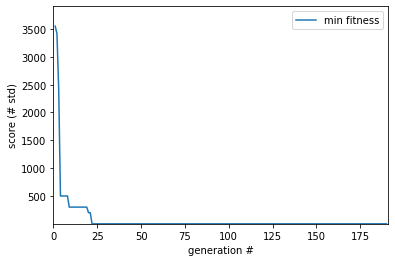

In [10]:


# The optimisation has return us 4 objects: final population, hall of fame, statistical logs and history. 
# 
# The final population contains a list of tuples, with each tuple representing the two parameters of the model


#print('Final population: ', final_pop)


# The best individual found during the optimisation is the first individual of the hall of fame

best_ind = hall_of_fame[0]
#print('Best individual: ', best_ind)
#print('Fitness values: ', best_ind.fitness.values)


# We can evaluate this individual and make use of a convenience function of the cell evaluator to return us a dict of the parameters


best_ind_dict = cell_evaluator.param_dict(best_ind)
#print(cell_evaluator.evaluate_with_dicts(best_ind_dict))


model = cell_evaluator.cell_model
cell_evaluator.param_dict(best_ind)
model.attrs = {str(k):float(v) for k,v in cell_evaluator.param_dict(best_ind).items()}



opt = model.model_to_dtc()
opt.attrs = {str(k):float(v) for k,v in cell_evaluator.param_dict(best_ind).items()}

check_binary_match(target,opt)
inject_and_plot_passive_model(opt,second=target)


# As you can see the evaluation returns the same values as the fitness values provided by the optimisation output. 
# We can have a look at the responses now.

# In[ ]:


#plot_responses(twostep_protocol.run(cell_model=simple_cell, param_values=best_ind_dict, sim=nrn))
 


# Let's have a look at the optimisation statistics.
# We can plot the minimal score (sum of all objective scores) found in every optimisation. 
# The optimisation algorithm uses negative fitness scores, so we actually have to look at the maximum values log.

gen_numbers = logs.select('gen')
min_fitness = logs.select('min')
max_fitness = logs.select('max')
plt.plot(gen_numbers, min_fitness, label='min fitness')
plt.xlabel('generation #')
plt.ylabel('score (# std)')
plt.legend()
plt.xlim(min(gen_numbers) - 1, max(gen_numbers) + 1) 
plt.ylim(0.9*min(min_fitness), 1.1 * max(min_fitness)) 


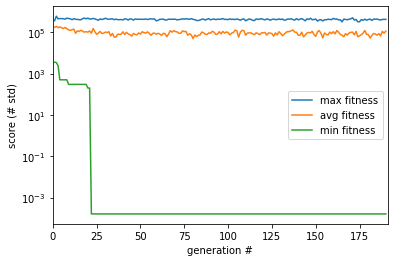

In [11]:
gen_numbers = logs.select('gen')
min_fitness = logs.select('min')
max_fitness = logs.select('max')
avg_fitness = logs.select('avg')

plt.clf()
plt.plot(gen_numbers, max_fitness, label='max fitness')
plt.plot(gen_numbers, avg_fitness, label='avg fitness')
plt.plot(gen_numbers, min_fitness, label='min fitness')

plt.xlabel('generation #')
plt.ylabel('score (# std)')
plt.yscale('log')

plt.legend()
plt.xlim(min(gen_numbers) - 1, max(gen_numbers) + 1) 
#plt.ylim(0.9*min(min_fitness), 1.1 * max(min_fitness)) 
plt.show()


<Figure size 432x288 with 0 Axes>

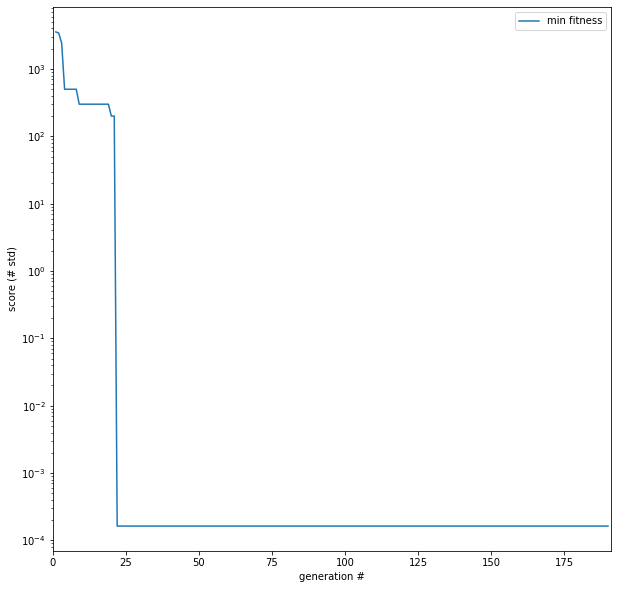

In [12]:
gen_numbers = logs.select('gen')
min_fitness = logs.select('min')
max_fitness = logs.select('max')
avg_fitness = logs.select('avg')

plt.clf()
fig = plt.figure(figsize=(10,10))
#ax = fig.add_subplot(1,1)

plt.plot(gen_numbers, min_fitness, label='min fitness')
#ax.semilogy()
#ax.set_yscale('log')
plt.yscale('log')

plt.xlabel('generation #')
plt.ylabel('score (# std)')
plt.legend()
plt.xlim(min(gen_numbers) - 1, max(gen_numbers) + 1) 
#plt.ylim(0.9*min(min_fitness), 1.1 * max(min_fitness)) 
plt.show()

[-65.22618636] mV [-65.22618636] mV


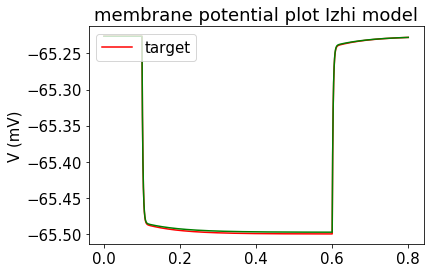

In [13]:
inject_and_plot_passive_model(opt,second=target,plotly=False)
best_ind_dict = cell_evaluator.param_dict(best_ind)
objectives = cell_evaluator.evaluate_with_dicts(best_ind_dict)

In [14]:
best_ind_dict = cell_evaluator.param_dict(best_ind)
objectives = cell_evaluator.evaluate_with_dicts(best_ind_dict)

model = cell_evaluator.cell_model
cell_evaluator.param_dict(best_ind)
model.attrs = {str(k):float(v) for k,v in cell_evaluator.param_dict(best_ind).items()}

opt = model.model_to_dtc()
opt.attrs = {str(k):float(v) for k,v in cell_evaluator.param_dict(best_ind).items()}
from neuronunit.optimisation.optimization_management import dtc_to_rheo, inject_and_plot_model30,check_bin_vm30,check_bin_vm15
opt = dtc_to_rheo(opt)
opt.rheobase
opt.attrs;
vm301,vm151,_,_,target = inject_and_plot_model30(target)
vm302,vm152,_,_,opt = inject_and_plot_model30(opt)


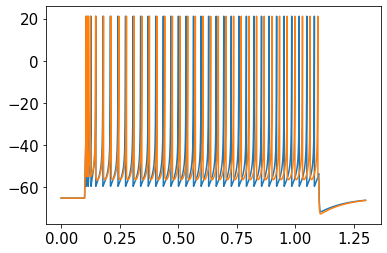

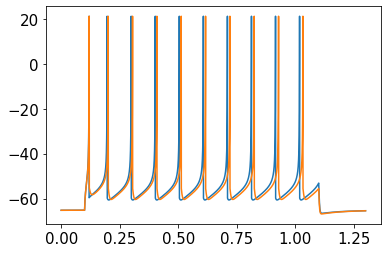

In [15]:
from neuronunit.optimisation.optimization_management import dtc_to_rheo, inject_and_plot_model30,check_bin_vm30,check_bin_vm15
check_bin_vm30(target,opt)
check_bin_vm15(target,opt)






In [16]:
def basic_expVar(trace1, trace2):
    # https://github.com/AllenInstitute/GLIF_Teeter_et_al_2018/blob/master/query_biophys/query_biophys_expVar.py
    '''This is the fundamental calculation that is used in all different types of explained variation.  
    At a basic level, the explained variance is calculated between two traces.  These traces can be PSTH's
    or single spike trains that have been convolved with a kernel (in this case always a Gaussian)
    Input:
        trace 1 & 2:  1D numpy array containing values of the trace.  (This function requires numpy array
                        to ensure that this is not a multidemensional list.)
    Returns:
        expVar:  float value of explained variance
    '''
    
    var_trace1=np.var(trace1)
    var_trace2=np.var(trace2)
    var_trace1_minus_trace2=np.var(trace1-trace2)

    if var_trace1_minus_trace2 == 0.0:
        return 1.0
    else:
        return (var_trace1+var_trace2-var_trace1_minus_trace2)/(var_trace1+var_trace2)
print(basic_expVar(target.vm15, opt.vm15))
print(basic_expVar(target.vm30, opt.vm30))

0.4499218818536691 dimensionless
0.3391891711386129 dimensionless


In [17]:
opt = dtc_to_rheo(opt)
print(opt.rheobase)
print(target.rheobase)


203.8616180419922 pA
207.6416015625 pA


0.7601728539310166 dimensionless variancce explained ratio at rheobase


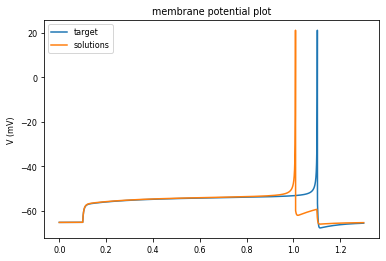

<Figure size 432x288 with 0 Axes>

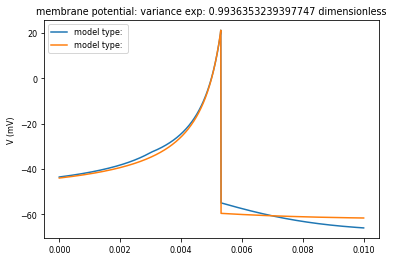

In [18]:

check_binary_match(opt,target,plotly=False,snippets=False)
check_binary_match(opt,target,plotly=False,snippets=True)
print(basic_expVar(target.vmrh, opt.vmrh), 'variancce explained ratio at rheobase')


In [19]:
params = {}
params['injected_square_current'] = {}
#if v.name in str('RestingPotentialTest'):
params['injected_square_current']['delay'] = PASSIVE_DELAY
params['injected_square_current']['duration'] = PASSIVE_DURATION
params['injected_square_current']['amplitude'] = 0.0*pq.pA    

In [20]:

opt_model = opt.dtc_to_model()
opt_model.inject_square_current(params)
opt_vm = opt_model.get_membrane_potential()
opt_vm[-1]

array([-65.22618636]) * mV

In [21]:
target_model = target.dtc_to_model()
target_model.inject_square_current(params)
target_vm = target_model.get_membrane_potential()
target_vm[-1]

array([-65.22618636]) * mV

In [22]:
best_ind = hall_of_fame[1]
#print('Best individual: ', best_ind)
#print('Fitness values: ', best_ind.fitness.values)


# We can evaluate this individual and make use of a convenience function of the cell evaluator to return us a dict of the parameters


best_ind_dict = cell_evaluator.param_dict(best_ind)
#print(cell_evaluator.evaluate_with_dicts(best_ind_dict))


model = cell_evaluator.cell_model
dtc= model.model_to_dtc()
opt = dtc_to_rheo(opt)
print(opt.rheobase)
print(target.rheobase)

203.8616180419922 pA
207.6416015625 pA


In [23]:
#model.rheobase
objectives

{'Spikecount_1.5x': 0.0, 'Spikecount_3.0x': 0.0}

In [25]:

best_ind_dict = cell_evaluator.param_dict(best_ind)
objectives = cell_evaluator.evaluate_with_dicts(best_ind_dict)

objectives2 = cell_evaluator2.evaluate_with_dicts(best_ind_dict)



In [26]:
import pandas as pd
import seaborn as sns
logbook = logs
#scores = [ m for m in logs ]
'''
list_of_dicts = []
df1 = pd.DataFrame()
genes=[]
for _,v in hist.genealogy_history.items():
    genes.append(v.fitness.values)
for j,i in enumerate(objectives.keys()):
    index = i.split('.')[0]
    df1[str(index)] = pd.Series(genes).values[j]#, index=df1.index)

'''
#MU =14
genes=[]
min_per_generations = []
for i,v in hist.genealogy_history.items():
    if i%MU==0:
        min_per_gen = sorted([(gene,np.min(gene)) for gene in genes],key=lambda x: x[1])
        min_per_generations.append(min_per_gen[0][0])
        genes =[]
    genes.append(v.fitness.values)
    
df2 = pd.DataFrame()
scores = []
for j,i in enumerate(objectives.keys()):
    index = i.split('.')[0]
    print([i[j] for i in min_per_generations ])
    df2[index] = pd.Series([i[j] for i in min_per_generations ])#, index=df1.index)
df2    


[100.0, 100.0, 100.0, 1.0000011478732387, 1.0000003678471385, 100.0, 1.0000004645414011, 1.0000003678471385, 1.1478729451190512e-06, 100.0, 1.0000003678471385, 1.1918770412762312e-07, 1.1918770412762312e-07, 100.0, 1.0000003678471385, 100.0, 2.000000057068405, 2.0000000155362874, 100.0, 2.1186476492742383e-07, 100.0, 100.0, 100.0, 1.0000010949081155, 1.1478732906223995e-06, 1.0000011478732211, 100.0, 100.0, 1.0000000729724718, 100.0, 100.0, 1.0000043172213473, 1.0000000729724718, 2.000004033117239, 2.1195860489820604e-07, 2.0000000387368977, 2.0000000387368977, 1.0000011478747721, 1.0000011478747721, 100.0, 2.0000000387368977, 100.0, 1.520959267216976e-08, 1.0000011478737107, 1.0000003609110149, 2.0000000387368977, 2.842866861614634e-08, 1.147873136156402e-06, 6.817247823643075e-08, 2.842866861614634e-08, 100.0, 2.842866861614634e-08, 100.0, 2.842866861614634e-08, 1.000001147873471, 2.842866861614634e-08, 100.0, 2.842866861614634e-08, 100.0, 100.0, 100.0, 2.842866861614634e-08, 2.00000

,Spikecount_1,Spikecount_3
0,1.000000e+02,1.451714e-08
1,1.000000e+02,1.451714e-08
2,1.000000e+02,2.000000e+00
3,1.000001e+00,1.000000e+00
4,1.000000e+00,1.000000e+00
...,...,...
383,4.105387e-06,4.934332e-09
384,2.000001e+00,2.000000e+00
385,2.769682e-07,6.278809e-10
386,1.000000e+00,1.000000e+00


In [27]:
number=int(np.sqrt(len(df2.columns)))

IndexError: too many indices for array

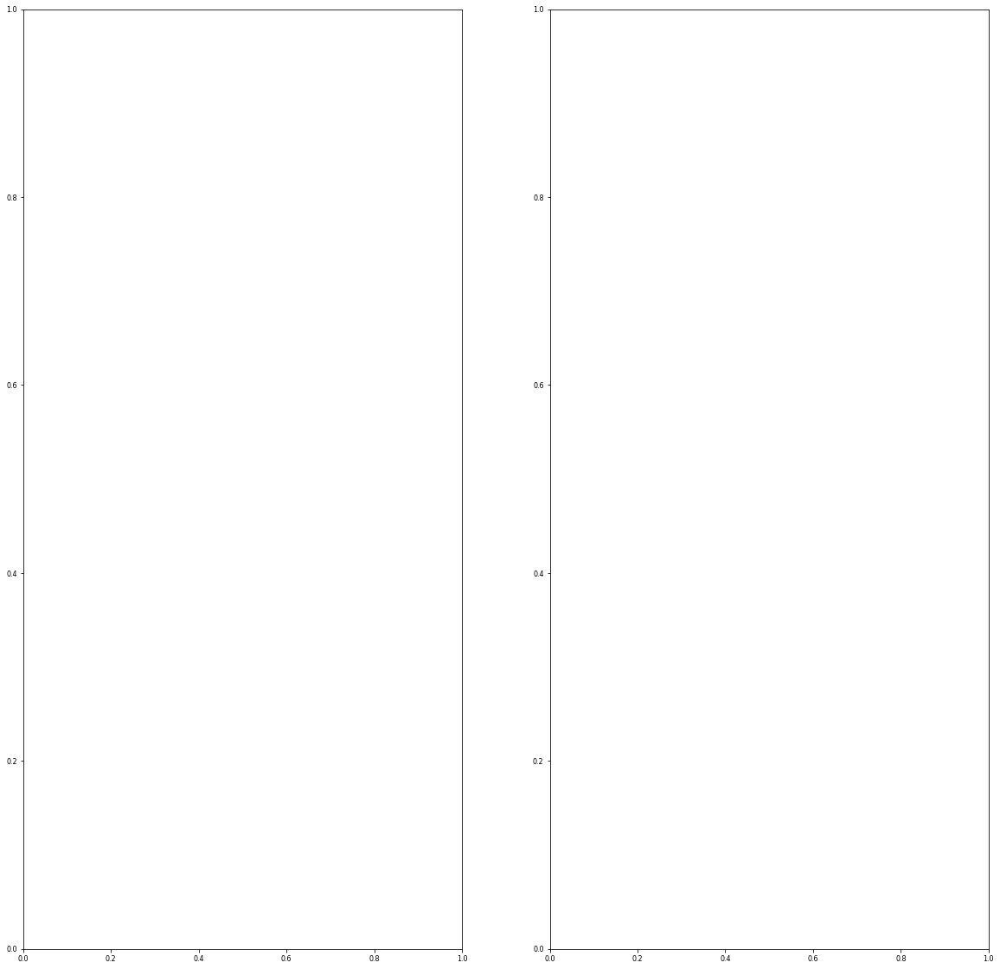

In [43]:
import math
box = int(np.sqrt(len(objectives)))
fig,axes = plt.subplots(box,box+1,figsize=(20,20))#math.ceil(len(objectives)/2+1),figsize=(20,20))
#axes[0,0].plot(scores)
#axes[0,0].plot(gen_numbers, min_fitness, label='min fitness')

axes[0,0].set_title('Observation/Prediction Disagreement')
for i,c in enumerate(df2.columns):
    ax = axes.flat[i+1]
    history = df2[c]
    #mn = mean[k.name] 
    #st = std[k.name] 
    #history = [(j[i]-mn)/st for j in scores ]
    #ax.axhline(y=mn , xmin=0.02, xmax=0.99,color='red',label='best candidate sampled')

    #ax.axvline(x=min_x , ymin=0.02, ymax=0.99,color='blue',label='best candidate sampled')
    ax.plot(history)
    ax.set_title(str(c))
    #bigger = np.max([np.max(history),mn])
    #smaller = np.max([np.min(history),mn])

    #ax.set_ylim([np.min(history),np.max(history)])
    #ax.set_ylabel(str(front[0].dtc.tests[i].observation['std'].units))
axes[0,0].set_xlabel("Generation")
axes[0,0].set_ylabel("standardized error")

plt.tight_layout()
#if figname is not None:
#    plt.savefig(figname)
#else:
plt.show()

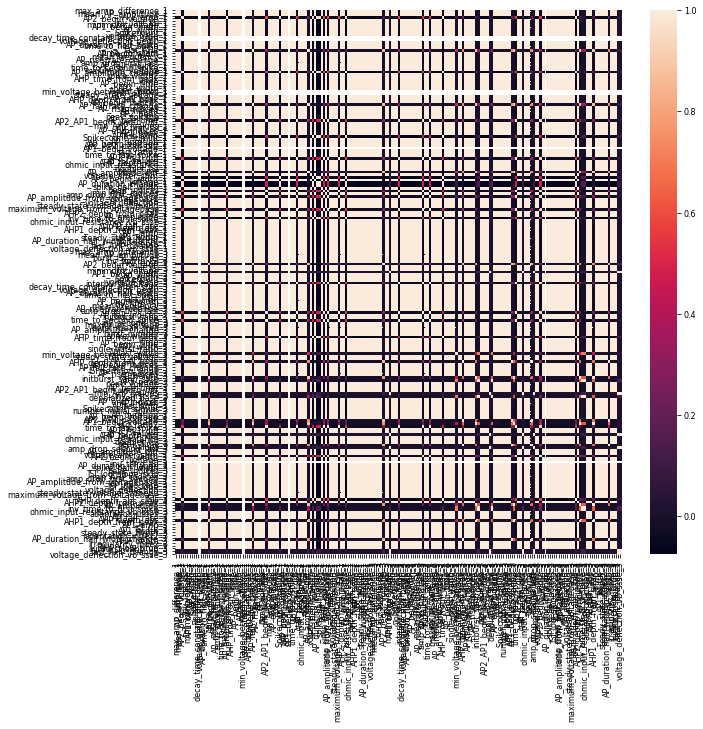

23977.406011912753


In [45]:

logbook = logs
#scores = [ m for m in logs ]
list_of_dicts = []
df1 = pd.DataFrame()
genes=[]
for _,v in hist.genealogy_history.items():
    genes.append(v.fitness.values)
for j,i in enumerate(objectives2.keys()):
    index = i.split('.')[0]
    df1[str(index)] = pd.Series(genes).values[j]#, index=df1.index)


    
#if normalize:
#    a = (a - mean(a)) / (std(a) * len(a))
#    v = (v - mean(v)) /  std(v)

df1=(df1-df1.mean())/df1.std()

corr = df1.corr()#.normalize()
fig =plt.figure(figsize=(10,10))
sns.heatmap(corr, 
        xticklabels=corr.columns,
        yticklabels=corr.columns)#, annot=True)
plt.show()
print(np.sum(np.sum(corr)))

In [ ]:

    
logbook = logs
#scores = [ m for m in logs ]
list_of_dicts = []
df1 = pd.DataFrame()
genes=[]
for _,v in hist.genealogy_history.items():
    genes.append(v.fitness.values)
for j,i in enumerate(objectives2.keys()):
    index = i.split('.')[0]
    df1[str(index)] = pd.Series(genes).values[j]#, index=df1.index)


    
#if normalize:
#    a = (a - mean(a)) / (std(a) * len(a))
#    v = (v - mean(v)) /  std(v)

df1=(df1-df1.mean())/df1.std()

corr = df1.corr()#.normalize()
fig =plt.figure(figsize=(10,10))
sns.heatmap(corr, 
        xticklabels=corr.columns,
        yticklabels=corr.columns)#, annot=True)
plt.show()
print(np.sum(np.sum(corr)))

In [ ]:
hist.genealogy_history.keys();

In [29]:
hist.genealogy_tree.keys();

In [30]:
import networkx
graph = networkx.DiGraph(hist.genealogy_tree)
graph = graph.reverse()     # Make the graph top-down
per_generation = [(gen,hist.genealogy_history[gen].fitness.values) for gen in graph]

In [31]:
per_generation

[(1,
  (100.0,
   1.4517140978675779e-08,
   100.0,
   7.05782722559971e-08,
   1.147874464449318e-06,
   1.1552810594241668e-09,
   0.0,
   0.0,
   0.0,
   0.0,
   1.937e-07,
   6.497774836781499e-08,
   1.1439285780025293e-06,
   1.3769232624469986e-06,
   2.6048997225571597e-08,
   1.865563494542942e-07,
   2.4471622662325625e-08,
   1.4078425011159705e-07,
   100.0,
   100.0,
   4.241648982571901e-08,
   100.0,
   5.4075983353575056e-08,
   100.0,
   100.0,
   2.3477843145930296e-06,
   0.0,
   1.8495095968728943e-07,
   100.0,
   1.4978896121126037e-08,
   100.0,
   5.453146995031359e-10,
   0.0,
   8.224971337222987e-10,
   1.849509596872777e-07,
   100.0,
   2.807271366194357e-07,
   3.440632418249438e-08,
   100.0,
   3.440632418249438e-08,
   3.337824257051303e-07,
   100.0,
   1.0454315514880935e-08,
   1.147874464449318e-06,
   4.240092227779631e-08,
   5.4075983353575056e-08,
   3.580878589836342e-08,
   4.827645810336734e-07,
   3.3352729622251633e-07,
   5.500826739340099

In [32]:
graph.nodes

NodeView((1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220

In [33]:
cp['halloffame'][-1].fitness.values

(1.0, 0.0)

In [34]:
cp['halloffame'][0].fitness.values

(0.0, 0.0)

In [35]:
cp['population'][-1].fitness.values

(0.0, 0.0)

In [36]:
final_pop 
hall_of_fame[-1].fitness.values

(2.7909085873199643e-07,
 6.382528206166606e-10,
 3.4281445334667e-08,
 2.879345266154677e-08,
 6.591541812834359e-07,
 7.579639291530648e-11,
 4.804314275460828e-08,
 0.0,
 0.0,
 0.0,
 1.1433683062337396e-07,
 6.373589960738077e-09,
 1.1439285780025293e-06,
 2.3514265953376484e-08,
 3.3706735344616436e-09,
 5.728965249520125e-07,
 8.09195469274351e-09,
 2.5952931548061136e-07,
 8.381601366699188e-08,
 2.7909137826276906e-07,
 9.103426822250565e-08,
 2.443288672922898e-07,
 2.426571166519656e-16,
 6.250176667759928e-07,
 4.751553604386659e-07,
 9.306525633552856e-07,
 0.0,
 1.6492448936452907e-07,
 4.7500623807908707e-07,
 4.750806993808337e-07,
 3.1187678059473303e-09,
 1.972957931238545e-09,
 0.0,
 1.67472653752625e-09,
 1.6492448936451915e-07,
 2.7237742400214366e-07,
 5.233673280980292e-07,
 2.557680838233557e-09,
 4.226760241714627e-08,
 2.557680838233557e-09,
 2.8926082756851773e-07,
 3.090037153144344e-15,
 3.1154976865922037e-09,
 6.591541812834359e-07,
 9.100013124821843e-08,


In [37]:
len(hall_of_fame)

10

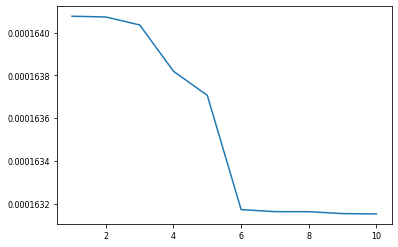

In [38]:
plt.plot([i for i in range(len(hall_of_fame),0,-1)],[np.sum(i.fitness.values) for i in hall_of_fame])

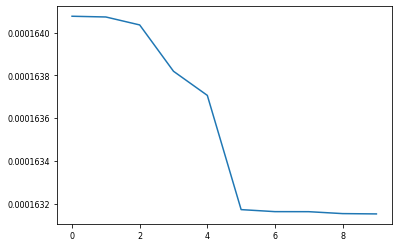

In [39]:
plt.plot([i for i in range(0,len(hall_of_fame))],[np.sum(hall_of_fame[i].fitness.values) for i in range(len(hall_of_fame)-1,-1,-1)])

In [40]:
genes=[]

for v in hall_of_fame:
    #v = hall_of_fame[j]
    genes.append(v.fitness.values)

#for i in 
#    plt.plot([i for i in range(0,len(hall_of_fame))],[hall_of_fame[i].fitness.values[j] for i in range(len(hall_of_fame)-1,-1,-1)])
#    plt.show()
df1 = pd.DataFrame()


INFO:numexpr.utils:NumExpr defaulting to 4 threads.


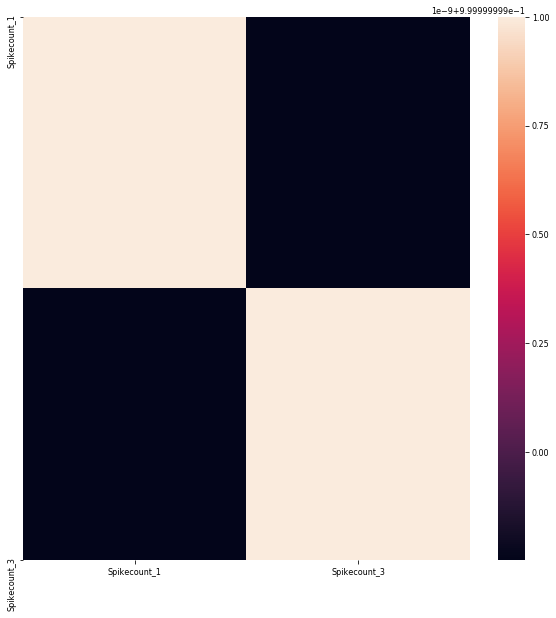

In [41]:
for j,i in enumerate(objectives.keys()):
    index = i.split('.')[0]
    df1[str(index)] = pd.Series(genes).values[j]#, index=df1.index)

df1=(df1-df1.mean())/df1.std()

corr = df1.corr()
fig =plt.figure(figsize=(10,10))
sns.heatmap(corr, 
        xticklabels=corr.columns,
        yticklabels=corr.columns)#, annot=True)
plt.show()

In [42]:
for j,i in enumerate(objectives2.keys()):
    index = i.split('.')[0]
    df1[str(index)] = pd.Series(genes).values[j]#, index=df1.index)

df1=(df1-df1.mean())/df1.std()

corr = df1.corr()
fig =plt.figure(figsize=(10,10))
sns.heatmap(corr, 
        xticklabels=corr.columns,
        yticklabels=corr.columns)#, annot=True)
plt.show()

IndexError: index 10 is out of bounds for axis 0 with size 10